In [1]:
import numpy as np
import biosppy

import pyhrv
import pyhrv.tools as tools
import pyhrv.frequency_domain as fd

import pandas as pd
import os, json


In [2]:
workDir = 'D:/LAB/放鬆-三總/Relaxing/分析'
os.chdir(workDir)


In [12]:
#ECG features
feature_names=['nni_mean','nni_counter','nni_min', 'nni_max', 
        'nni_diff_mean','nni_diff_min', 'nni_diff_max',
        'hr_mean','hr_min', 'hr_max', 'hr_std',
        'rmssd', 'sdnn', 'sdsd',
        'nn50','pnn50','nn20','pnn20',

        'vlf_peak', 'lf_peak' ,'hf_peak',
        'vlf_abs', 'lf_abs','hf_abs',
        'vlf_rel', 'lf_rel','hf_rel',
        'vlf_log', 'lf_log','hf_log',

        'fft_ratio', 'fft_total',

        'sd1', 'sd2','sd_ratio','ellipse_area','sampen']

# lable_names = ['addictLabel', 'stateLabel', 'trainingCount']
lable_names = ['addictLabel', 'stateLabel']

data_name = ['data_name']

# stageState = ['pre', 'VR', 'post']
# stageDuration = [300, 480, 300]
sampleRate = 2048
# stagePoint = [-1080*sampleRate, -780*sampleRate, -300*sampleRate,]

inputPath = "Data3group/EKG/"
rriPath = "Data3group/RRI/"
featureOutputPath = "Data3group/Feature/"


In [13]:
def Output_rri_CSV(filePath, sampleRate, output=False):

    dataList = os.listdir(filePath)
    result = []
    for dataName in dataList:
        # if dataName == 'A33_VR_1_PreTest_EKG.csv' or dataName == 'A33_VR_1_PostTest_EKG.csv':
        #     continue
        
        # N01_VR_1_PreTest_Skin
        dataInfo = dataName[:-4].split('_')

        data = pd.read_csv("%s%s"%(filePath, dataName),  names=['TimeStamp', 'EKGdata'])

        # for i in range(0, 3): #3 stages
        #     if i != 2:
        #         stageData = data[stagePoint[i]:stagePoint[i+1]]
        #     elif i == 2:
        #         stageData = data[stagePoint[i]:]
            
        #     signals = biosppy.signals.ecg.ecg(signal=stageData['EKGdata'], sampling_rate=sampleRate, show= False)
        #     rpeaks_idx = signals["rpeaks"]
        #     rri_list = tools.nn_intervals(rpeaks=rpeaks_idx) / sampleRate

        #     time_list = []
        #     temp = 0
        #     for rri in rri_list:
        #         temp += rri
        #         time_list.append(temp)

        #     stageResult = {'time':time_list, 'data':rri_list}
        #     stageResult = pd.DataFrame(data=stageResult)

        #     if output:
        #         stageResult.to_csv("%s%s_%s.csv"%(rriPath, dataName[:-4], stageState[i]))

        signals = biosppy.signals.ecg.ecg(signal=data['EKGdata'], sampling_rate=sampleRate, show= False)
        rpeaks_idx = signals["rpeaks"]
        rri_list = tools.nn_intervals(rpeaks=rpeaks_idx) / sampleRate

        time_list = []
        temp = 0
        for rri in rri_list:
            temp += rri
            time_list.append(temp)

        stageResult = {'time':time_list, 'data':rri_list}
        stageResult = pd.DataFrame(data=stageResult)

        if output:
            stageResult.to_csv("%s%s%s_%s.csv"%(rriPath, dataInfo[0], dataInfo[1][0], dataInfo[3][:-4]))
        


In [5]:
def save_freq_features(data, dic):
    dic['vlf_peak'] = data['fft_peak'][0]
    dic['lf_peak'] = data['fft_peak'][1]
    dic['hf_peak'] = data['fft_peak'][2]
    dic['vlf_abs'] = data['fft_abs'][0]
    dic['lf_abs'] = data['fft_abs'][1]
    dic['hf_abs'] = data['fft_abs'][2]
    dic['vlf_rel'] = data['fft_rel'][0]
    dic['lf_rel'] = data['fft_rel'][1]
    dic['hf_rel'] = data['fft_rel'][2]
    dic['vlf_log'] = data['fft_log'][0]
    dic['lf_log'] = data['fft_log'][1]
    dic['hf_log'] = data['fft_log'][2]
    return dic

In [6]:
#EKG to RRI
Output_rri_CSV(inputPath, sampleRate, output=True)


In [7]:
def set_label(dataInfo):
    addictLabel = int(dataInfo[0][0] == 'A')

    # if len(dataInfo) == 2:
    #     trainingCount = 1
    #     state = dataInfo[1]
    # elif len(dataInfo) == 3:
    #     trainingCount = int(dataInfo[1])
    #     state = dataInfo[2]
    
    if dataInfo[1] == "Pre":
        stateLabel = 0
    elif dataInfo[1] == "VR":
        stateLabel = 1
    elif dataInfo[1] == "Post":
        stateLabel = 2
    else:
        print('No this state!!!!')
        stateLabel = -1

    # label = {'addictLabel' : addictLabel, 'stateLabel':stateLabel, 'trainingCount': trainingCount}
    label = {'addictLabel' : addictLabel, 'stateLabel':stateLabel}
    
    return label


In [8]:
def RRItoFeature(rriPath, output = False):
    
    dataList = os.listdir(rriPath)
    name = pd.DataFrame(columns = data_name)
    result = pd.DataFrame(columns=feature_names)
    lable = pd.DataFrame(columns=lable_names)

    for dataName in dataList:
        if dataName == 'A33_Pre.csv' or dataName == 'A33_Post.csv':
            continue
        # N01_Pre
        dataInfo = dataName[:-4].split('_')
        
        rri = pd.read_csv("%s%s"%(rriPath, dataName), index_col=0)
        try:
            features = pyhrv.hrv(nni = rri["data"], show=False)
        except Exception as e:
            print(dataInfo, e)
            continue
        
        dic = {}
        for feature in feature_names:
            try:
                dic[feature] = features[feature]
            except Exception as e:
                pass
        
        dic = save_freq_features(features, dic)

        # name = name.append({"data_name" : "%s"%(dataName[:-4])}, ignore_index= True)
        datanameDF = pd.DataFrame({'data_name' : ["%s"%(dataName[:-4])]})
        name = pd.concat([name, datanameDF], axis=0, ignore_index= True)
        # result = result.append(dic, ignore_index=True)
        result = pd.concat([result, pd.DataFrame(dic, index=[0])], axis=0, ignore_index=True)
        # lable = lable.append(set_label(dataInfo), ignore_index=True)
        lable = pd.concat([lable, pd.DataFrame(set_label(dataInfo), index=[0])], axis=0, ignore_index=True)
        
        

    result = name.join(result)
    result = result.join(lable)

    if output:
        result.to_csv('%sHRV_Features.csv'%(featureOutputPath))
        
    return result

c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '
c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib

['A95V', 'Pre'] float division by zero


c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '
c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib

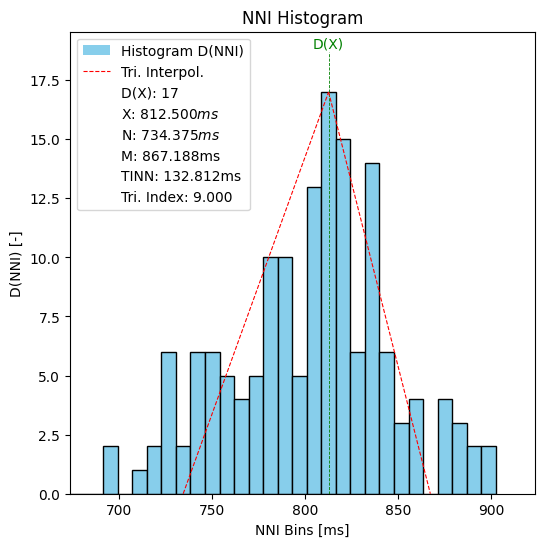

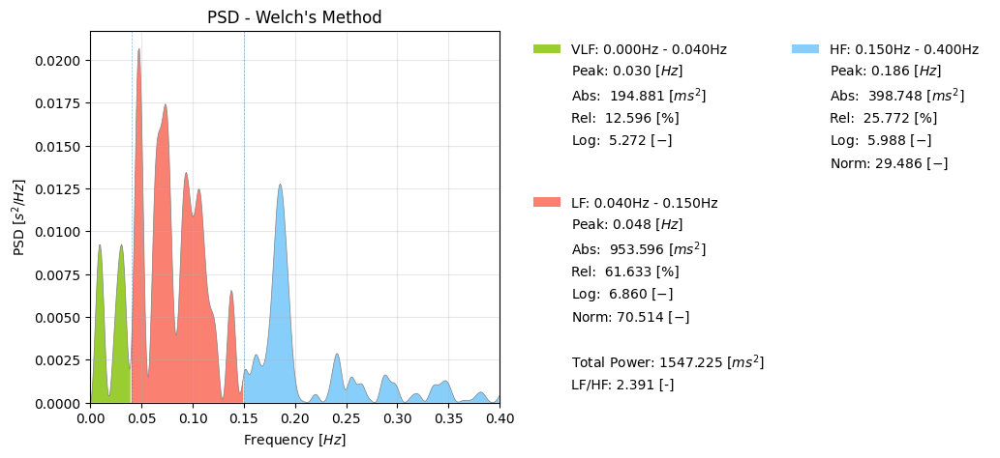

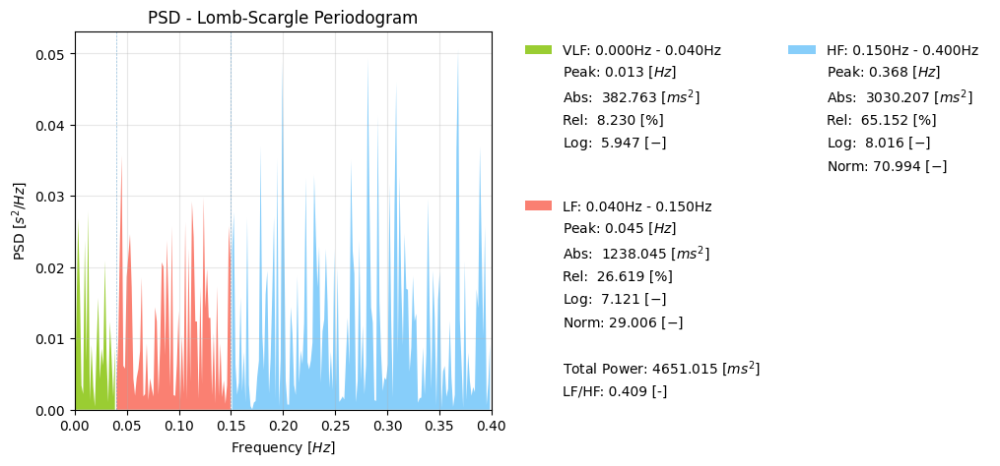

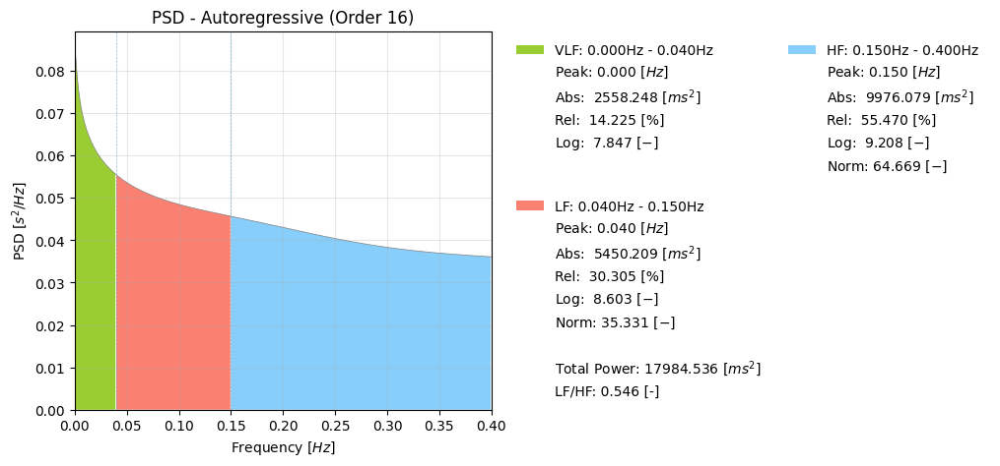

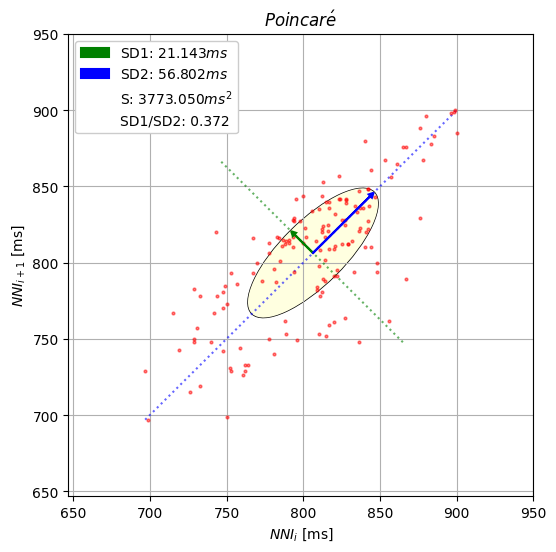

...

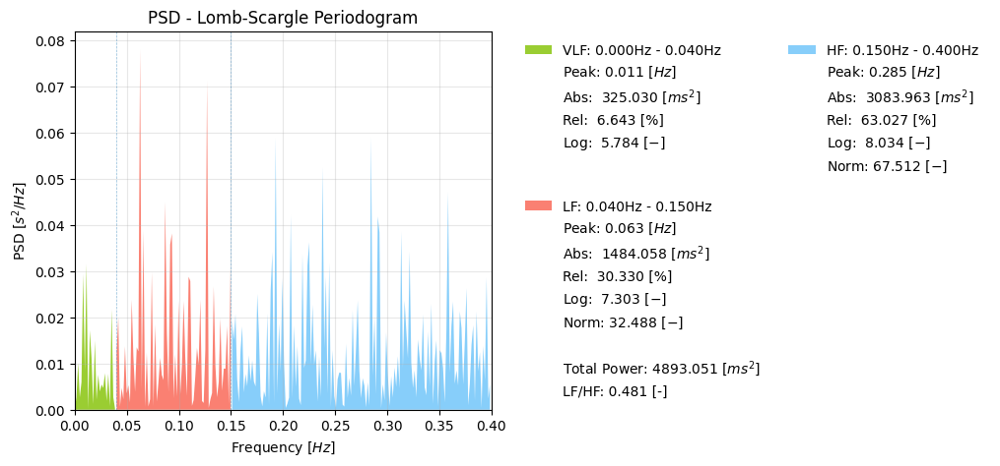

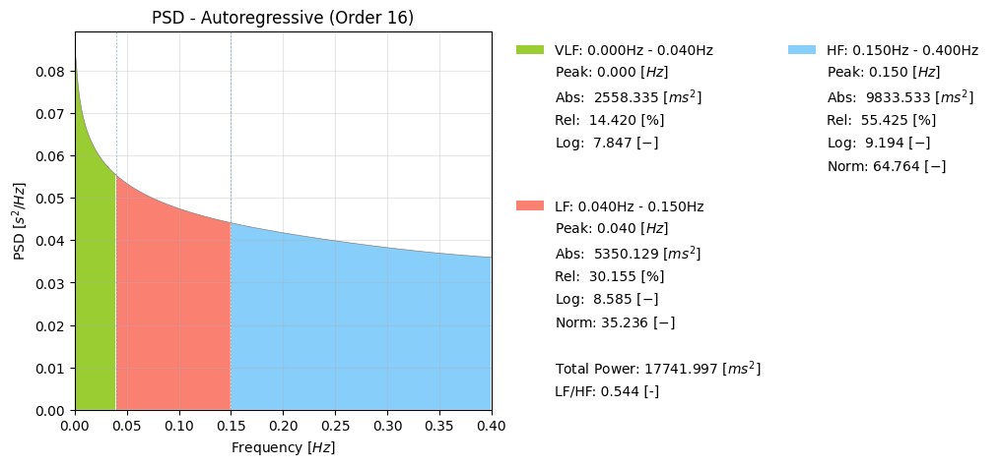

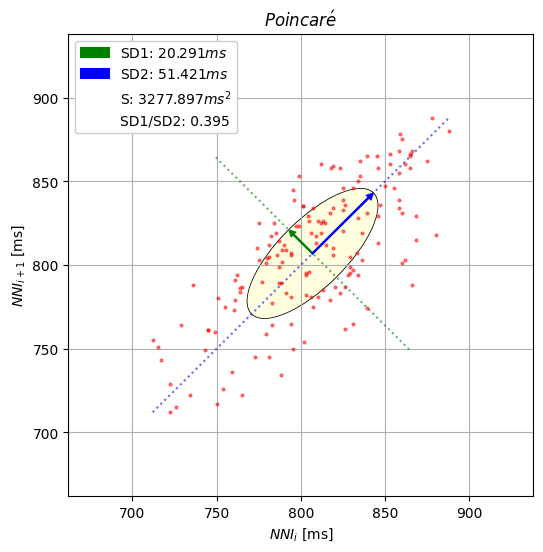

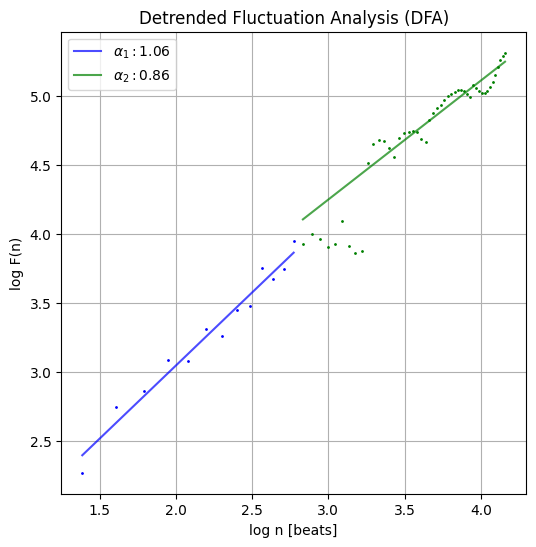

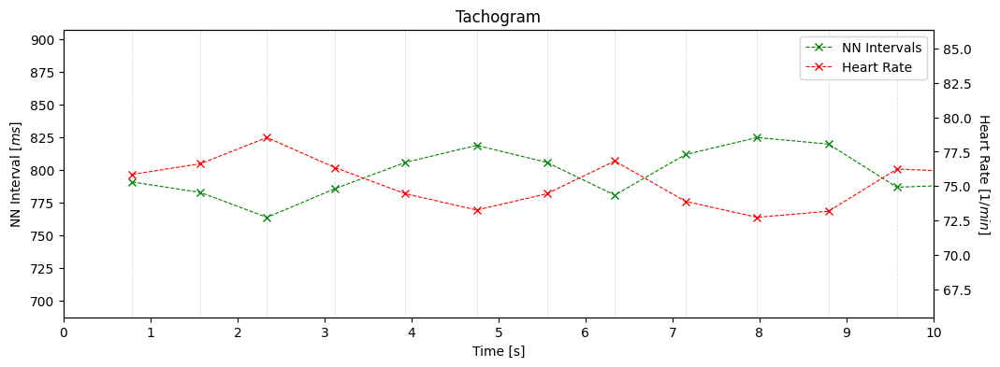

In [14]:
#this section compute feature and output

result = RRItoFeature(rriPath, False)

    

In [13]:
result

,data_name,nni_mean,nni_counter,nni_min,nni_max,nni_diff_mean,nni_diff_min,nni_diff_max,hr_mean,hr_min,...,hf_log,fft_ratio,fft_total,sd1,sd2,sd_ratio,ellipse_area,sampen,addictLabel,stateLabel
0,A100C_Post,806.359477,153,697.0,900.0,23.953947,0,94,74.623887,66.666667,...,5.988330,2.391474,1547.225225,21.143434,56.802461,2.686530,3773.049958,1.506025,1,2
1,A100C_Pre,777.582278,158,643.0,916.0,24.764331,0,207,77.673395,65.502183,...,5.829431,1.847654,2956.282408,25.811599,84.937518,3.290672,6887.543312,1.284512,1,0
2,A101V_Post,835.250000,148,735.0,899.0,16.578231,0,81,71.952699,66.740823,...,5.334261,2.963932,990.055956,16.195727,44.185545,2.728222,2248.177252,1.639743,1,2
3,A101V_Pre,831.662162,148,725.0,906.0,18.217687,0,73,72.373687,66.225166,...,5.386143,4.097961,2004.500602,17.222424,63.012074,3.658723,3409.321151,1.110704,1,0
4,A102C_Post,845.472603,146,734.0,946.0,26.551724,0,101,71.212727,63.424947,...,5.946741,1.736799,1804.387686,23.422244,65.504992,2.796700,4820.063690,1.561810,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,A97V_Pre,767.149068,161,629.0,864.0,22.893750,0,129,78.567196,69.444444,...,5.615632,2.704956,1416.899984,23.297387,67.589079,2.901144,4946.905592,1.304616,1,0
73,A98C_Post,831.751678,149,671.0,929.0,32.162162,0,150,72.490960,64.585576,...,6.481052,3.733840,3419.693273,31.503629,73.062874,2.319189,7231.147265,1.443453,1,2
74,A98C_Pre,772.584906,159,688.0,900.0,20.949367,0,112,77.888814,66.666667,...,5.779112,3.143321,1624.808725,19.917467,55.725775,2.797834,3486.904843,1.602517,1,0
75,A99V_Post,847.643836,146,667.0,981.0,26.648276,0,214,71.431024,61.162080,...,6.671149,1.909574,7500.987835,28.279991,107.170762,3.789632,9521.502031,1.093549,1,2


In [15]:
result.to_csv('Feature3group/HRV.csv')

# Garmin HRV

c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
c:\Users\WMlab\.pyenv\pyenv-win\versions\3.10.10\lib\site-packages\pyhrv\time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


No this state!!!!


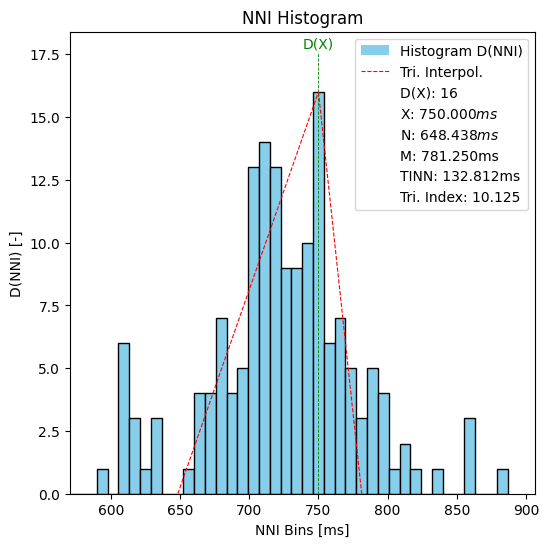

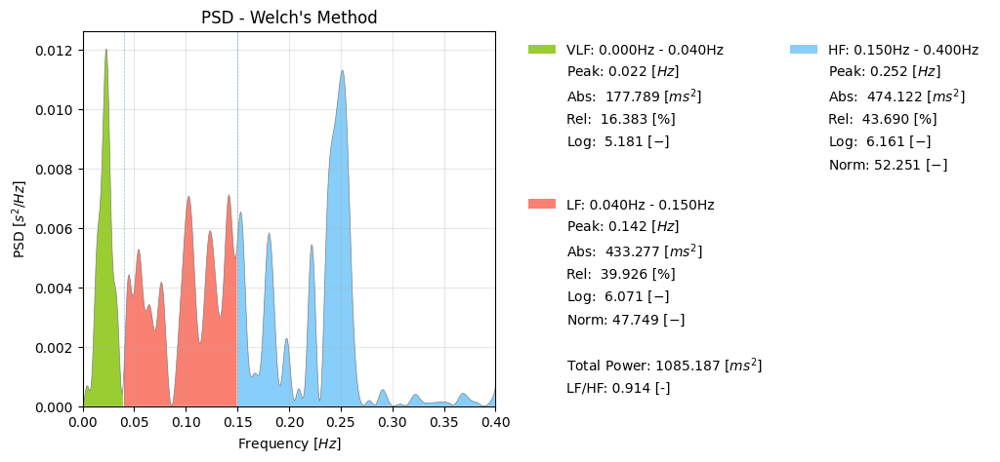

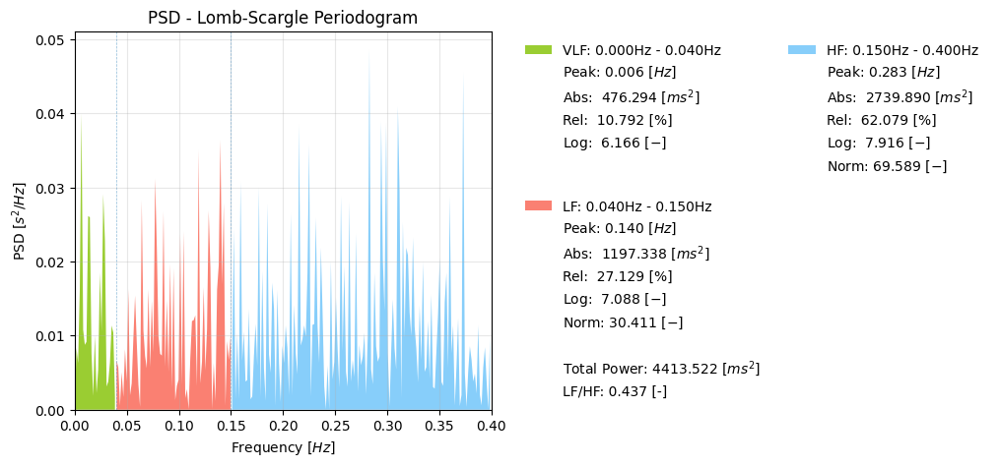

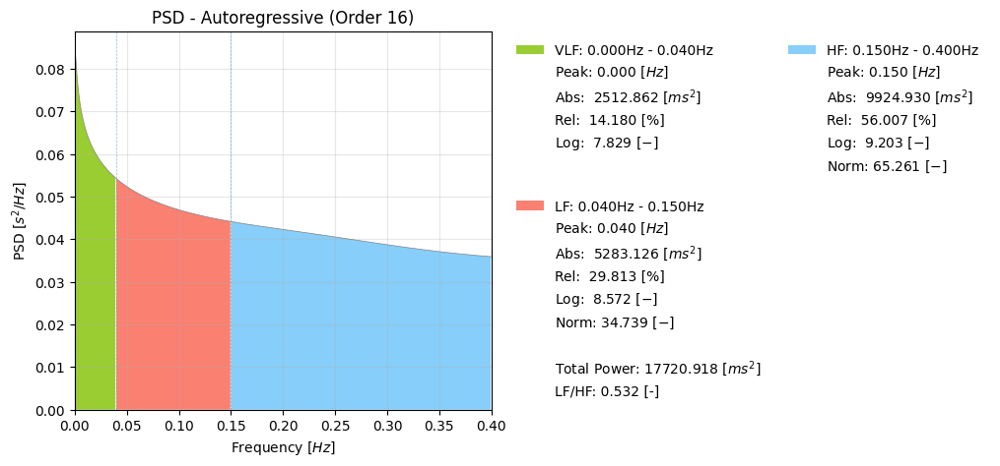

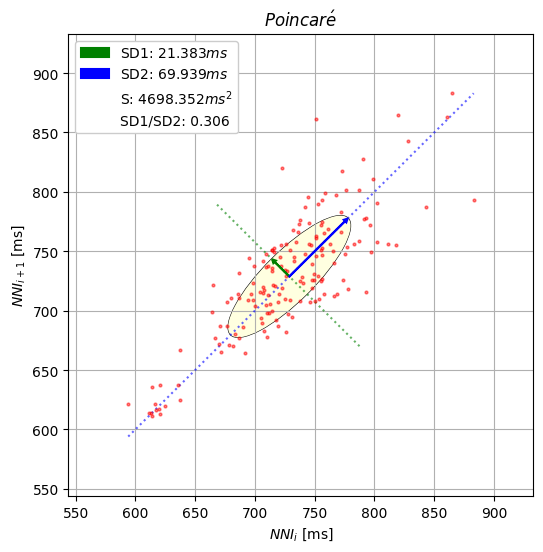

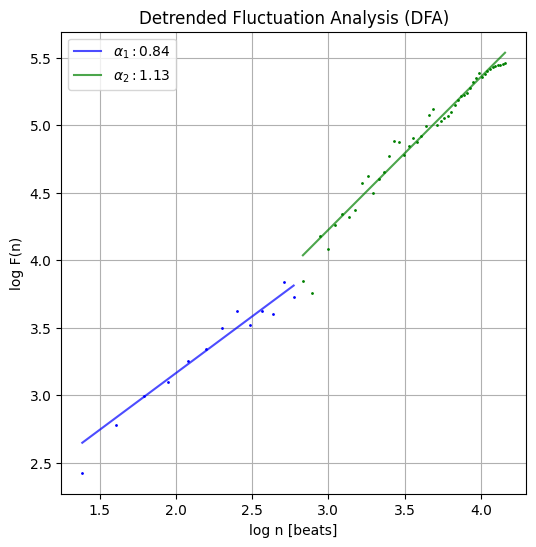

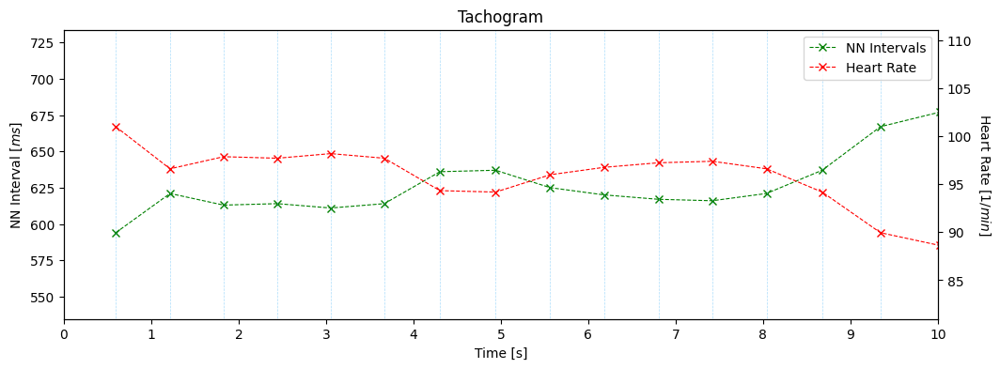

In [17]:
# GhrvData = pd.read_csv("Data/result_pcjson.com.csv", header=0, index_col=0)
name = pd.DataFrame(columns = data_name)
result = pd.DataFrame(columns=feature_names)
lable = pd.DataFrame(columns=lable_names)

rri = pd.read_csv("Data/result_pcjson.com.csv")
hrv = rri["heartRateVariability"]
hrv = hrv.loc[hrv.shift() != hrv]
# print(hrv[0:5])
features = pyhrv.hrv(nni = hrv, show=False)
dic = {}
for feature in feature_names:
    try:
        dic[feature] = features[feature]
    except Exception as e:
        pass

dic = save_freq_features(features, dic)

datanameDF = pd.DataFrame({'data_name' : ["GarminTest1229"]})
name = pd.concat([name, datanameDF], axis=0, ignore_index= True)
result = pd.concat([result, pd.DataFrame(dic, index=[0])], axis=0, ignore_index=True)
lable = pd.concat([lable, pd.DataFrame(set_label("N01_Pre"), index=[0])], axis=0, ignore_index=True)
    
    

result = name.join(result)
result = result.join(lable)
result.to_csv('Data/GraminTest1229.csv')